# Setup

In [1]:
from setup import *

In [2]:
aus = City('Austin, TX')
cam = City('Cambridge, MA')
tor = City('City of Toronto', 'Toronto')

In [3]:
cities = [cam, tor, aus]

In [4]:
od_fname = 'sample_OD_n1000000_seed1234_d800m'

In [5]:
colors = dict(current='#DB7F57', sidewalks='#61C314', crosswalks='#12BFF6', both='#BF54F2')

---
# Create pednet variants

In [6]:
%%time
# t = 22s
pns = [Pednet(*params, od_fname) for params in tqdm([
    # Cambridge
    (cam, 'exists', 'current'),
    (cam, 'exists or is_xwalk', 'crosswalks'),
    # Austin
    (aus, 'exists', 'current'),
    (aus, 'exists or ~is_xwalk', 'sidewalks'),
    (aus, 'exists or is_xwalk', 'crosswalks'),
    (aus, None, 'both'),
    # Toronto
    (tor, 'exists', 'current'),
    (tor, 'exists or ~is_xwalk', 'sidewalks'),
    (tor, 'exists or is_xwalk', 'crosswalks'),
    (tor, None, 'both'),
])]
for c in cities:
    c.pn = {pn.name: pn for pn in pns if pn.city == c}

  0%|          | 0/10 [00:00<?, ?it/s]

CPU times: user 16.9 s, sys: 1.31 s, total: 18.2 s
Wall time: 18.9 s


## Load saved edges

In [7]:
%time for pn in pns: pn.E = pd.read_pickle(pn.city.root + f'edges/{pn.name}.pickle') # t = 4s

CPU times: user 1.86 s, sys: 252 ms, total: 2.12 s
Wall time: 2.32 s


## Load paths

In [8]:
%%time
# t = 46s
for c in tqdm(cities):
    c.sp = {name: pd.read_pickle(glob(c.root + f'paths/{name}_*od.pickle')[0]) for name, pn in c.pn.items()}

  0%|          | 0/3 [00:00<?, ?it/s]

CPU times: user 25.7 s, sys: 4.31 s, total: 30 s
Wall time: 34.6 s


## Summarize

In [9]:
Pdf([{
    'city': pn.city.name, 'pednet': pn.name,
    'n_nodes': pn.V.shape[0],
    'n_clusters': np.unique(pn.G.clusters().membership).size,
    'n_edges': pn.E.shape[0],
    'n_SW': pn.E.query('~is_xwalk').shape[0],
    'n_CW': pn.E.query('is_xwalk').shape[0],
    'length_total_mi': int(pn.E['len'].sum() * U.M2MI),
    'length_SW_mi': int(pn.E.query('~is_xwalk')['len'].sum() * U.M2MI),
    'length_CW_mi':int(pn.E.query('is_xwalk')['len'].sum() * U.M2MI),
} for pn in pns])

/tmp/ipykernel_274197/1996964286.py:4: DeprecationWarning: Graph.clusters() is deprecated; use Graph.connected_components() instead
  'n_clusters': np.unique(pn.G.clusters().membership).size,


,city,pednet,n_nodes,n_clusters,n_edges,n_SW,n_CW,length_total_mi,length_SW_mi,length_CW_mi
0,Cambridge,current,13563,2076,13398,10840,2558,481,453,27
1,Cambridge,crosswalks,13563,1980,14131,10840,3291,489,453,35
2,Austin,current,239208,11319,231565,225583,5982,3741,3653,87
3,Austin,sidewalks,270712,8511,270472,264490,5982,7323,7236,87
4,Austin,crosswalks,251754,7702,267369,225583,41786,4142,3653,489
5,Austin,both,270712,1863,306276,264490,41786,7725,7236,489
6,Toronto,current,47584,228,61349,52042,9307,5063,4889,173
7,Toronto,sidewalks,64380,10,86770,77463,9307,6903,6730,173
8,Toronto,crosswalks,47728,268,64939,52042,12897,5112,4889,223
9,Toronto,both,64380,10,90360,77463,12897,6953,6730,223


---
# Distributions by pednet variant

## Edge weight & pednet score

In [10]:
def plot_distr_pn_attr(pns, attr, xlab, title, ncols=3, 
                       dpi=90, xeng=0, ylog=0, cmap='Set2'):
    nrows = (len(pns) // ncols) + 1
    fig, ax = plt.subplots(nrows, ncols, figsize=(4*ncols, 2.5*nrows), dpi=dpi)
    ax = ax.flatten()
    colors = {c: sns.color_palette(cmap)[i] for i, c in enumerate({pn.city for pn in pns})}
    for i, pn in enumerate(pns):
        pn.E[attr].pipe(lambda x: x[x > 0]).hist(bins=50, ax=ax[i], color=colors[pn.city])
        U.plot(ax[i], ylog=ylog, title=str(pn).replace('Pednet(', ''), yeng=1, xeng=xeng,
               ylab='No. of edges', xlab=xlab)
    fig.suptitle(title, fontsize=20)
    plt.tight_layout()

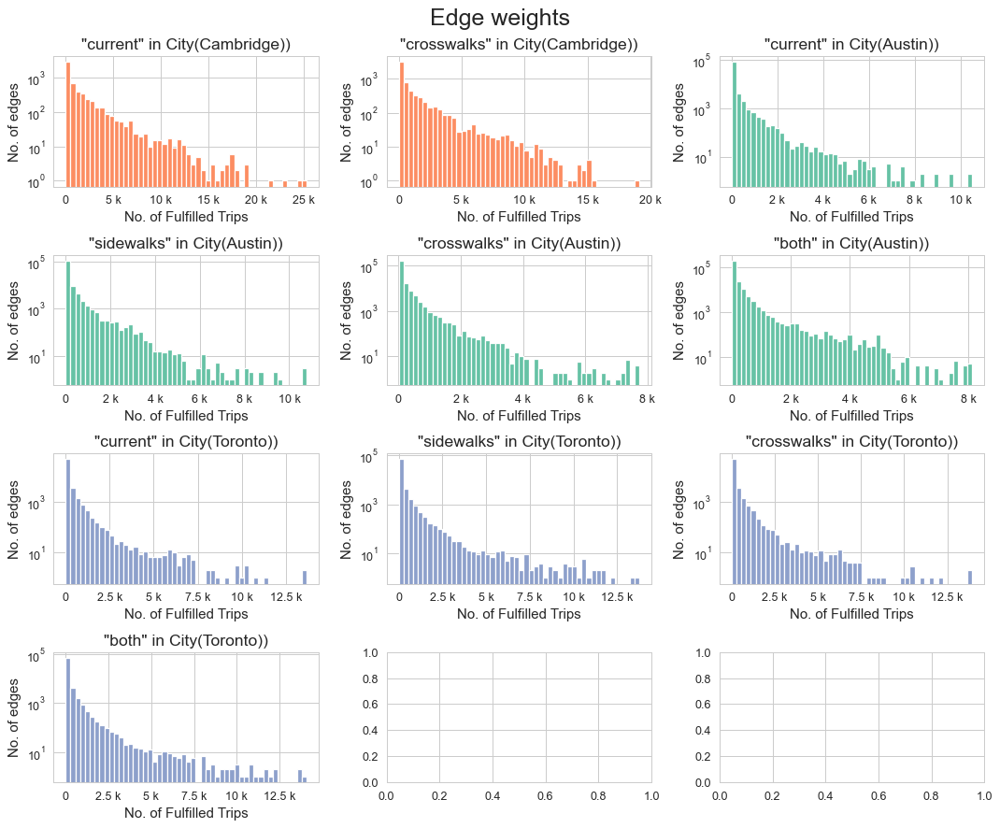

In [11]:
plot_distr_pn_attr(pns, 'n_trips', 'No. of Fulfilled Trips', 'Edge weights', ylog=1, xeng=1)
P.imsave('Edge weight distributions by city and pednet variants')

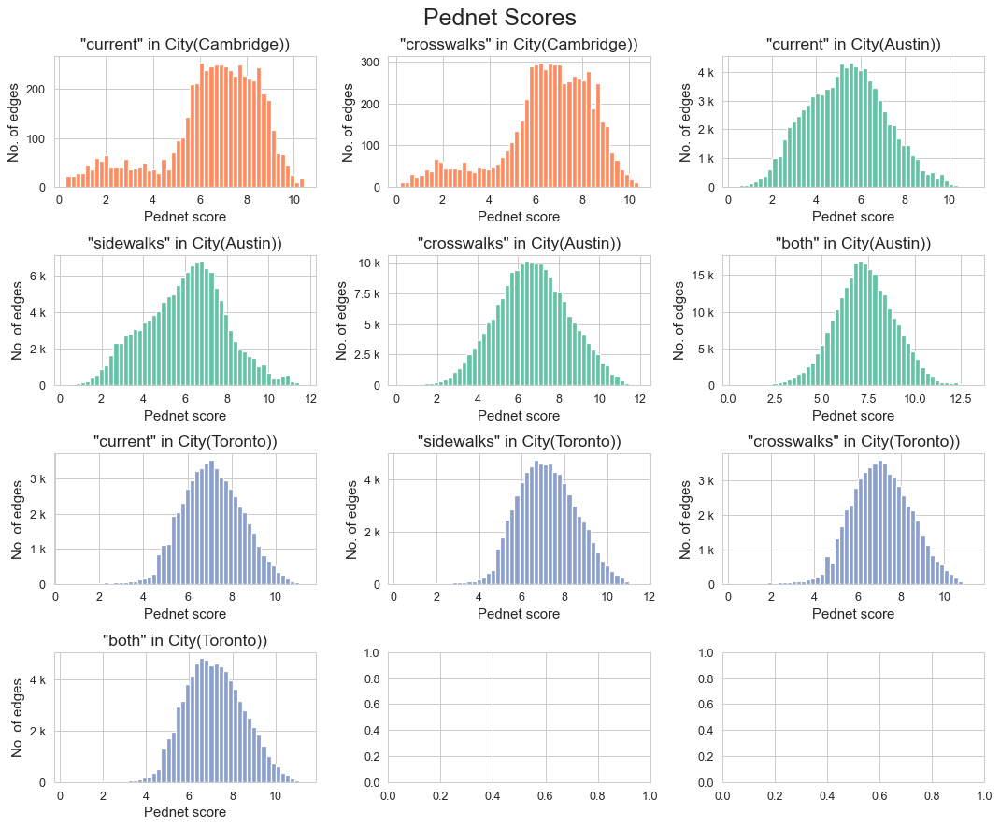

In [12]:
plot_distr_pn_attr(pns, 'pedscore', 'Pednet score', 'Pednet Scores')
P.imsave('Pednet score distributions by city and pednet variants')

## Multiple attributes

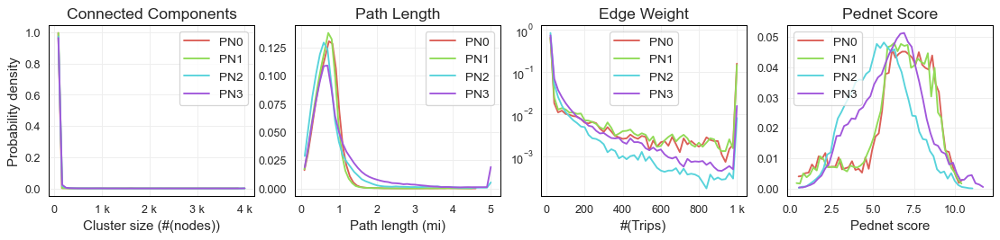

In [13]:
def plot_edge_attr_distr(pns, cum=True, nbins=50, size=(15, 2.8),
                         dpi=90, cmap='hls', label_info=False):
    fig, ax = plt.subplots(1, 4, figsize=size, dpi=dpi)
    for i, pn in enumerate(pns):
        color = sns.color_palette('hls', len(pns))[i]
        
        # Connected components
        U.plot(ax[0], ylab='Cumulative probability' if cum else 'Probability density',
               xlab='Cluster size (#(nodes))', title='Connected Components', xeng=1)
        y, x = np.histogram(pn.V['cid'].value_counts().clip(0, 4000), bins=nbins)
        y = y.cumsum() / y.sum() if cum else y / y.sum()
        lab = ' ({round(pn.V.cid.nunique()/1000)}k clusters)' if label_info else ''
        ax[0].plot(x[1:], y, color=color, label=f'PN{i}')
        
        # Path length
        U.plot(ax[1], ylab='', xlab='Path length (mi)', title='Path Length')
        y, x = np.histogram((pn.city.sp[pn.name]['d_V2V'] * U.M2MI).clip(0, 5), bins=nbins)
        y = y.cumsum() / y.sum() if cum else y / y.sum()
        lab = f' ({round(pn.sp.shape[0]/1000)}k paths)' if label_info else ''
        ax[1].plot(x[1:], y, color=color, label=f'PN{i}' + lab)
        
        # Trip counts
        U.plot(ax[2], ylab='', xlab='#(Trips)', title='Edge Weight', xeng=1, ylog=1)
        y, x = np.histogram(pn.E['n_trips'].clip(0, 1000), bins=nbins)
        y = y.cumsum() / y.sum() if cum else y / y.sum()
        lab = f' ({round(pn.E.shape[0]/1000)}k edges)' if label_info else ''
        ax[2].plot(x[1:], y, color=color, label=f'PN{i}' + lab)
        
        # Pednet score
        U.plot(ax[3], ylab='', xlab='Pednet score', title='Pednet Score')
        y, x = np.histogram(pn.E['pedscore'].pipe(lambda x: x[x > 0]), bins=nbins)
        y = y.cumsum() / y.sum() if cum else y / y.sum()
        ax[3].plot(x[1:], y, color=color, label=f'PN{i}')
    
    for x in ax:
        x.legend()
        x.grid(color='#eee')
        for k in ['left','top','right','bottom']:
            x.spines[k].set_color('k')
    
plot_edge_attr_distr(pns[:4], cum=False)
P.imsave('Edge attribute PDF - Austin')

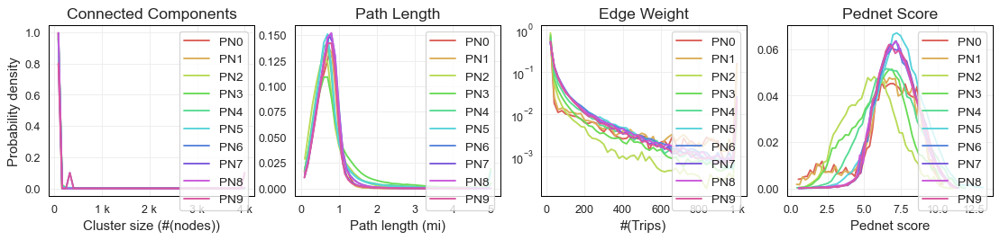

In [14]:
plot_edge_attr_distr(pns, cum=False)
P.imsave('Edge attribute PDF - all cities')

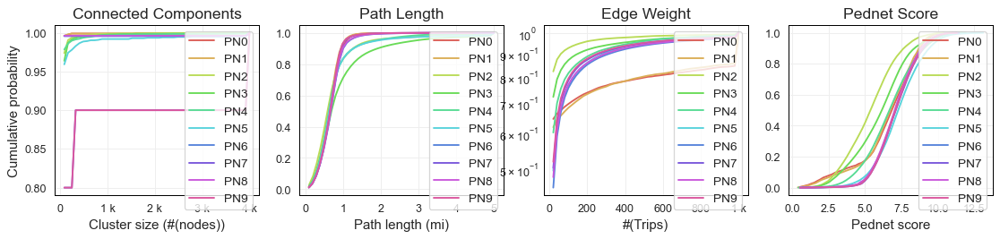

In [15]:
plot_edge_attr_distr(pns)
P.imsave('Edge attribute CDF - all cities')

## Trip metrics (figure)

In [16]:
for pn in pns:
    print(f'{pn.city.name}: {pn.name} -> {pn.city.sp[pn.name].n_ods.sum():,}', )

Cambridge: current -> 393,960
Cambridge: crosswalks -> 407,357
Austin: current -> 270,368
Austin: sidewalks -> 466,934
Austin: crosswalks -> 526,811
Austin: both -> 909,617
Toronto: current -> 803,914
Toronto: sidewalks -> 999,241
Toronto: crosswalks -> 804,258
Toronto: both -> 999,241


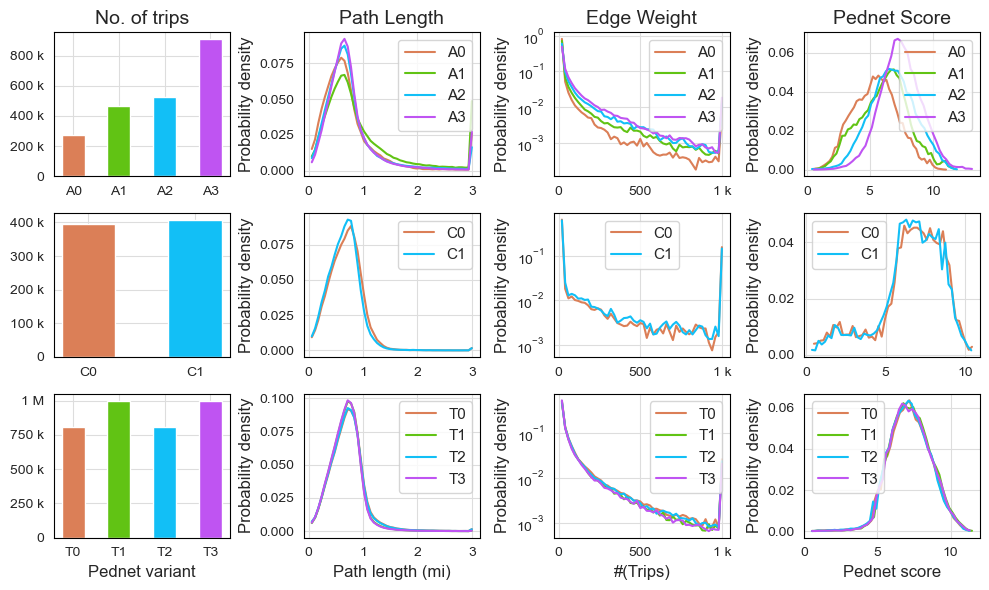

In [19]:
def plot_edge_attr_distr(cities, cum=False, nbins=50, h=2, w=10,
                         dpi=100, cmap='hls', label_info=False):
    fig, ax = plt.subplots(len(cities), 4, figsize=(w, h*len(cities)), dpi=dpi)
    for c in cities:
        for i, pn in enumerate(c.pn.values()):
            pn.id = f'{c.name.upper()[0]}{i}'
    for i, c in enumerate(cities):
        # No. of trips
        U.plot(ax[i,0], xlab='Pednet variant' if i == len(cities) - 1 else '',
               ylab='', yeng=True, title='No. of trips' if i == 0 else '')
        x, y, col = list(zip(*[(f'{c.name.upper()[0]}{i}', sp['n_ods'].sum(), colors[name]) 
                                  for i, (name, sp) in enumerate(c.sp.items())]))
        ax[i,0].bar(x, y, color=col, width=0.5)
        
        for name, sp in c.sp.items():
            pn, color = c.pn[name], colors[name]
            # Path length
            U.plot(ax[i,1], xlab='Path length (mi)' if i == len(cities) - 1 else '',
                   ylab='Probability density', title='Path Length' if i == 0 else '')
            y, x = np.histogram((sp['d_V2V'] * U.M2MI).clip(0, 3), bins=nbins)
            y = y.cumsum() / y.sum() if cum else y / y.sum()
            ax[i,1].plot(x[1:], y, color=color, label=pn.id)
            
            # Trip counts (edge weights)
            U.plot(ax[i,2], xlab='#(Trips)' if i == len(cities) - 1 else '',
                   ylab='Probability density', title='Edge Weight' if i == 0 else '', xeng=1, ylog=1)
            y, x = np.histogram(pn.E['n_trips'].clip(0, 1000), bins=nbins)
            y = y.cumsum() / y.sum() if cum else y / y.sum()
            lab = f' ({round(pn.E.shape[0]/1000)}k edges)' if label_info else ''
            ax[i,2].plot(x[1:], y, color=color, label=pn.id)
        
            # Pednet score
            U.plot(ax[i,3], xlab='Pednet score' if i == len(cities) - 1 else '',
                   ylab='Probability density', title='Pednet Score' if i == 0 else '')
            y, x = np.histogram(pn.E['pedscore'].pipe(lambda x: x[x > 0]), bins=nbins)
            y = y.cumsum() / y.sum() if cum else y / y.sum()
            ax[i,3].plot(x[1:], y, color=color, label=pn.id)
        for j in range(4):
            ax[i,j].legend() if j != 0 else None
            ax[i,j].grid(color='#ddd')
            for k in ['left','top','right','bottom']:
                ax[i,j].spines[k].set_color('k')
    plt.tight_layout()

plot_edge_attr_distr([aus, cam, tor])
P.imsave('Pednet variant distributions by city')

# Spatial distribution

## Compare variants

CPU times: user 2.08 s, sys: 150 ms, total: 2.23 s
Wall time: 1.95 s


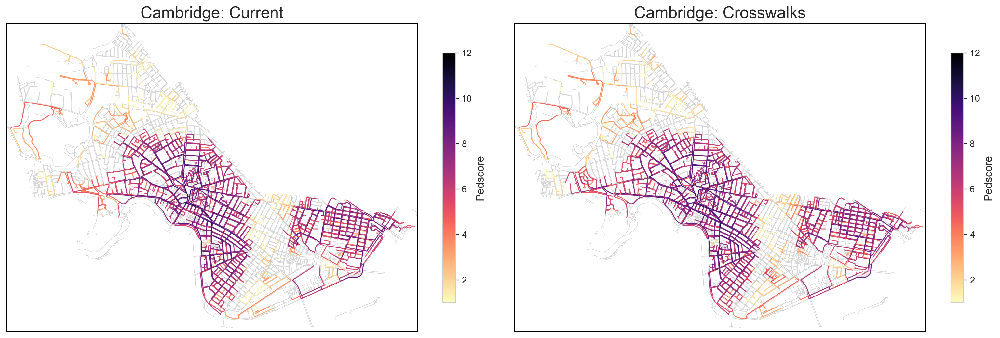

In [20]:
def plot_map_pn_scores(city, var='pedscore', bbox=None, vmin=0, vmax=500, size=8, dpi=90, cmap='magma_r'):
    fig, ax = plt.subplots(1, len(city.pn), figsize=(size*len(city.pn), size), dpi=dpi)
    for ax, pn in zip(ax, city.pn.values()):
        E = pn.E.set_crs(CRS_DEG).to_crs(CRS_M)
        if bbox is not None and len(bbox) == 4:
            miny, minx, maxy, maxx = bbox
            E = E.cx[minx:maxx, miny:maxy]
        else:
            b = E.bounds
            minx, miny, maxx, maxy = b.minx.min(), b.miny.min(), b.maxx.max(), b.maxy.max()
        ax.set_xlim(minx, maxx); ax.set_ylim(miny, maxy)
        ax.tick_params(axis='both', which='both', bottom=False, left=False,
                       labelbottom=False, labelleft=False)
        ax.set_title(f'{pn.city.name}: {pn.name.title()}', fontsize=18); ax.grid(False)
        E.plot(ax=ax, color='lightgrey', linewidth=0.5)
        E.query(f'{var} >= {vmin}').plot(
            ax=ax, column=var, cmap=cmap, vmin=vmin, vmax=vmax,
            linewidth=1, legend=True, legend_kwds=dict(shrink=0.5, label=var.title()))
        for x in 'left bottom right top'.split():
            ax.spines[x].set_color('k')
    plt.tight_layout()
            
%time plot_map_pn_scores(cam, vmin=1, vmax=12, dpi=200) # t = 3s
P.imsave('Pednet score map - Cambridge')

CPU times: user 15.5 s, sys: 310 ms, total: 15.8 s
Wall time: 15.4 s


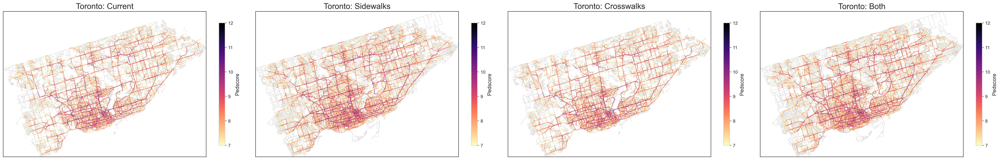

In [21]:
%time plot_map_pn_scores(tor, vmin=7, vmax=12, dpi=200) # t = 22s
P.imsave('Pednet score map - Toronto')

CPU times: user 1min 22s, sys: 1.66 s, total: 1min 23s
Wall time: 1min 23s


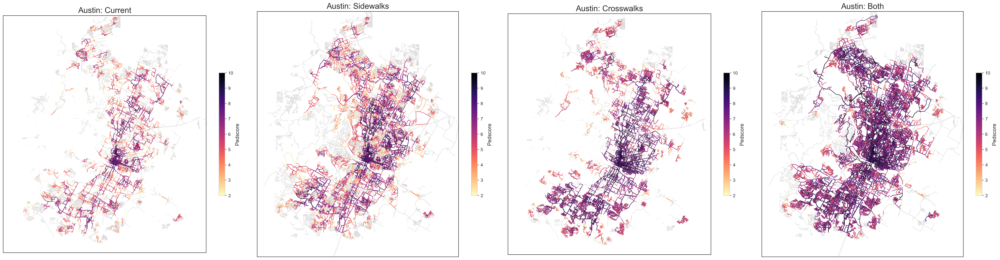

In [22]:
%time plot_map_pn_scores(aus, vmin=2, vmax=10, dpi=200) # t = 1min 44s
P.imsave('Pednet score map - Austin')

# Top critical links

## Austin

In [23]:
aus.npa = gpd.read_file(aus.root + 'neighborhood_planning_areas.zip').to_crs(CRS_DEG).disp()

65 rows x 6 cols; Memory: 0.0 MiB; CRS: EPSG:4326


,_feature_i,planning_a,shape_area,shape_leng,label,geometry
,<float64>,<object>,<float64>,<float64>,<object>,<geometry>
0,1.0,ALLANDALE,65792689.5531,42253.10721,Allandale,"POLYGON ((-97.739741 30.328079, -97.739617 30...."


CPU times: user 10.7 s, sys: 280 ms, total: 11 s
Wall time: 10.5 s


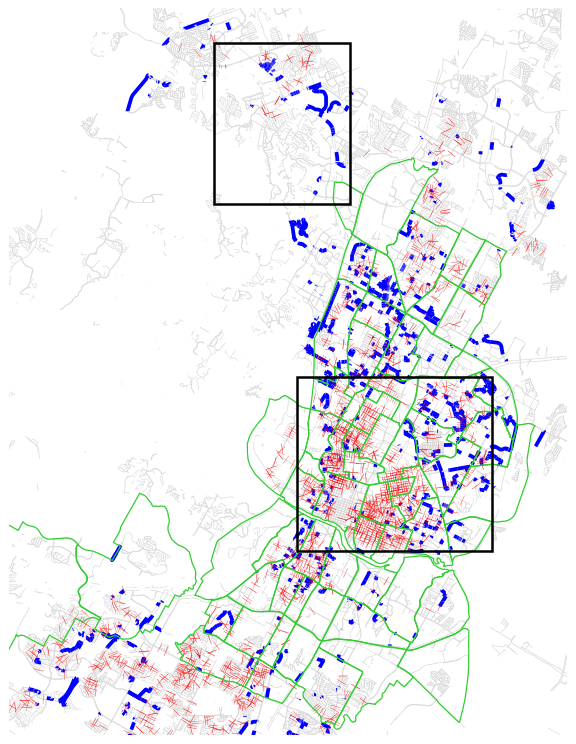

In [24]:
%%time
# t = 16s
maxx, miny, minx, maxy = -97.63765, 30.47036, -97.89772,30.17786
ax = U.plot(size=(8, 12), dpi=90, axoff=True, xlim=(minx, maxx), ylim=(miny, maxy))
ax.invert_yaxis()
miny, minx, maxy, maxx = 30.25202, -97.76336, 30.32199, -97.67255
ax.add_patch(mpl.patches.Rectangle((minx, miny), maxx-minx, maxy-miny, fill=False, edgecolor='k', linewidth=2, zorder=200))
miny, minx, maxy, maxx = 30.39162, -97.80205, 30.45626, -97.73892
ax.add_patch(mpl.patches.Rectangle((minx, miny), maxx-minx, maxy-miny, fill=False, edgecolor='k', linewidth=2, zorder=200))
aus.pn['current'].E.plot(ax=ax, color='lightgrey', linewidth=0.5)
aus.pn['sidewalks'].E.query('~exists').sort_values('pedscore').tail(2000).plot(ax=ax, color='blue', linewidth=3)
aus.pn['crosswalks'].E.query('~exists').sort_values('pedscore').tail(2000).plot(ax=ax, color='red', linewidth=8)
aus.npa.plot(ax=ax, facecolor='none', edgecolor='limegreen', zorder=100)
for k in ['left','top','right','bottom']: ax.spines[k].set_color('k')
P.imsave('Critical link map - top 2000 - Austin')

CPU times: user 1.97 s, sys: 230 ms, total: 2.2 s
Wall time: 1.74 s


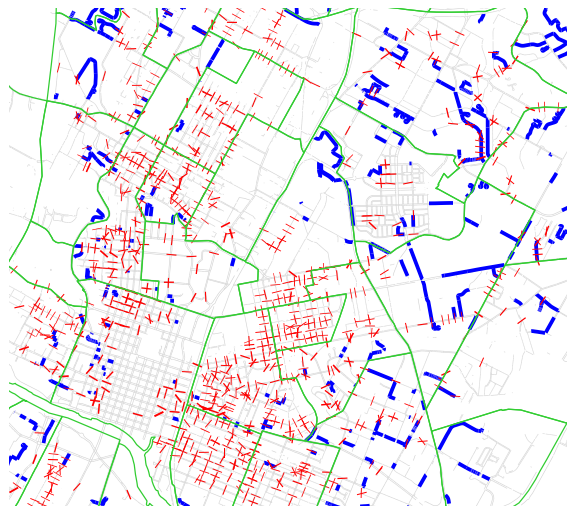

In [25]:
%%time
miny, minx, maxy, maxx = 30.252022, -97.763364, 30.321987, -97.672549
ax = U.plot(size=(8, 12), axoff=True, dpi=90, xlim=(minx, maxx), ylim=(miny, maxy))
aus.pn['current'].E.cx[minx:maxx, miny:maxy].query('exists').plot(ax=ax, color='lightgrey', linewidth=0.5)
aus.pn['sidewalks'].E.query('~exists').sort_values('pedscore').tail(2000).cx[minx:maxx, miny:maxy].plot(ax=ax, color='blue', linewidth=3)
aus.pn['crosswalks'].E.query('~exists').sort_values('pedscore').tail(2000).cx[minx:maxx, miny:maxy].plot(ax=ax, color='red', linewidth=8)
aus.npa.cx[minx:maxx, miny:maxy].plot(ax=ax, facecolor='none', edgecolor='limegreen', zorder=100)
P.imsave('Critical link map - top 2000 - Downtown Austin')

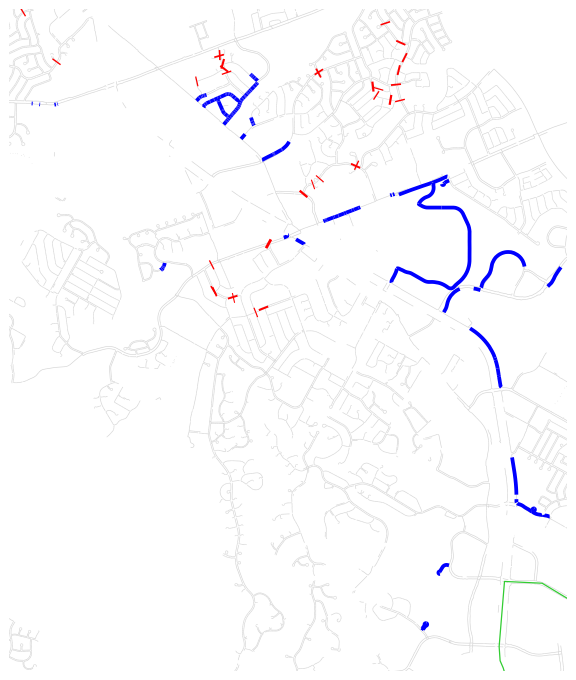

In [26]:
miny, minx, maxy, maxx = 30.391615, -97.802051, 30.456256, -97.738919
ax = U.plot(size=(8, 12), axoff=True, dpi=90, xlim=(minx, maxx), ylim=(miny, maxy))
aus.pn['current'].E.cx[minx:maxx, miny:maxy].query('exists').plot(ax=ax, color='lightgrey', linewidth=0.5)
aus.pn['sidewalks'].E.query('~exists').sort_values('pedscore').tail(2000).cx[minx:maxx, miny:maxy].plot(ax=ax, color='blue', linewidth=3)
aus.pn['crosswalks'].E.query('~exists').sort_values('pedscore').tail(2000).cx[minx:maxx, miny:maxy].plot(ax=ax, color='red', linewidth=8)
aus.npa.cx[minx:maxx, miny:maxy].plot(ax=ax, facecolor='none', edgecolor='limegreen', zorder=100)
P.imsave('Critical link map - top 2000 - Northwestern Austin')

## Crosswalks in Cambridge & Toronto

In [27]:
def plot_map_xwalk_priority(city, bbox=None, ticks=False, vmax=None, markersize=10, dpi=120):
    ax = U.plot(size=(15, 10), dpi=dpi, axoff=0)
    city.pn['current'].E.plot(ax=ax, color='#ccc', linewidth=0.5, zorder=-1)
    city.pn['current'].E.query('is_xwalk').plot(ax=ax, color='k', linewidth=1, zorder=-1)
    df = (city.pn['crosswalks'].E.query('~exists').set_crs(CRS_DEG)
          .sort_values('pedscore', ascending=False).iloc[:vmax].reset_index(drop=True)
          .to_crs(CRS_M).assign(geometry = lambda df: df.geometry.centroid).to_crs(CRS_DEG)
          .sort_index(ascending=False).reset_index())
    df.plot(ax=ax, column='index', cmap='rainbow_r', markersize=markersize,
            legend=True, vmin=0, vmax=vmax, legend_kwds=dict(
                shrink=0.4, orientation='horizontal',
                label='Candidate crosswalk priority rank (by pednet score)'))
    xmin, ymin, xmax, ymax = bbox or city.pn['current'].E.geometry.unary_union.bounds
    ax.set_xlim(xmin, xmax); ax.set_ylim(ymin, ymax);
    plt.setp(ax.spines.values(), color='k'); ax.grid(alpha=0.2)
    if not ticks:
        ax.tick_params(which='both', axis='both',
                       left=False, bottom=False, labelleft=False, labelbottom=False)

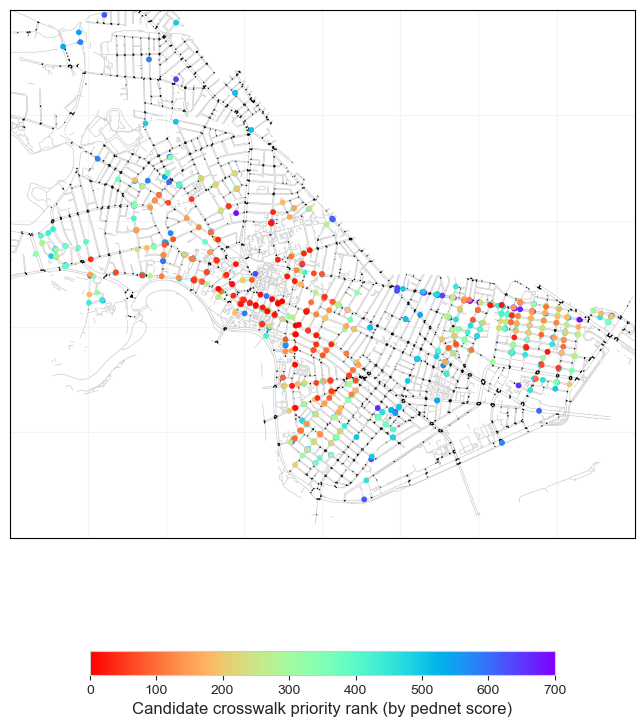

In [28]:
plot_map_xwalk_priority(cam, [-71.15, 42.35, -71.07, 42.40], vmax=700, dpi=100) # t = 2s
P.imsave('Critical link map - Cambridge')

CPU times: user 2.8 s, sys: 153 ms, total: 2.95 s
Wall time: 2.71 s


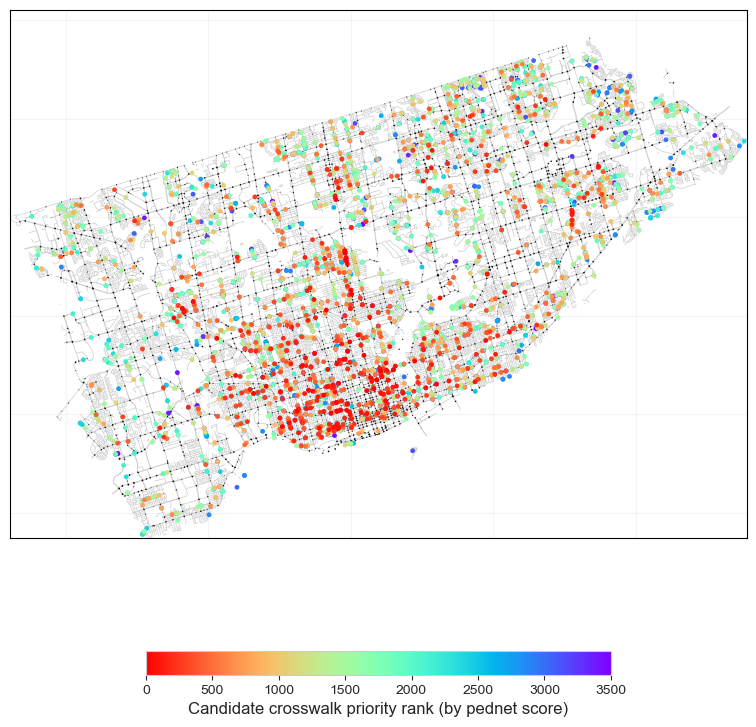

In [29]:
%time plot_map_xwalk_priority(tor, vmax=3500, markersize=6, dpi=100) # t = 3s
P.imsave('Critical link map - Toronto')

# Miscellaneous

## Correlation with population density

In [29]:
def corr_pedscore_vs_pop_density(city, kind='crosswalks'):
    acs = city.load('acs')[['geometry', 'popu']].astype({'popu': int}).query('popu > 0')
    acs['area'] = acs.geometry.to_crs(CRS_M).area * U.SQM2SQMI
    acs['pop_density'] = acs['popu'] / acs['area']
    xw = city.pn[kind].E.query('is_xwalk').set_crs(CRS_DEG)
    xw.geometry = xw.geometry.to_crs(CRS_M).centroid.to_crs(CRS_DEG)
    xw = gpd.sjoin(xw, acs[['geometry']].reset_index(), predicate='within')
    agg_scores = (xw.groupby(['exists', 'geoid'])['pedscore']
                  .agg(lambda x: np.median(x)).reset_index()
                  .merge(acs[['popu','pop_density']], on='geoid')
                  .assign(z_pop = lambda df: U.normalize(df.popu)))
    return agg_scores
    
cam.x = corr_pedscore_vs_pop_density(cam).disp()

181 rows x 6 cols; Memory: 0.0 MiB


,exists,geoid,pedscore,popu,pop_density,z_pop
,<bool>,<object>,<float64>,<int64>,<float64>,<float64>
0,False,250173508002,2.97174,876,12237.433222,0.25641


In [30]:
fig = px.scatter(cam.x, 'pop_density', 'pedscore', color='exists', size='z_pop')
fig.update_layout()

In [31]:
tor.x = corr_pedscore_vs_pop_density(tor).disp(0)

280 rows x 6 cols; Memory: 0.0 MiB


,exists,geoid,pedscore,popu,pop_density,z_pop
,<bool>,<int64>,<float64>,<int64>,<float64>,<float64>


In [32]:
fig = px.scatter(tor.x, 'pop_density', 'pedscore', color='exists', size='z_pop')
fig.update_layout()

In [33]:
aus.x = corr_pedscore_vs_pop_density(aus).disp()

1,280 rows x 6 cols; Memory: 0.1 MiB


,exists,geoid,pedscore,popu,pop_density,z_pop
,<bool>,<object>,<float64>,<int64>,<float64>,<float64>
0,False,482090109121,0.0,3920,144.40402,0.424839


In [34]:
fig = px.scatter(aus.x, 'pop_density', 'pedscore', color='exists', size='z_pop')
fig.update_layout()